# Anomalies

***

In [1]:
import numpy as np
import xarray as xr
from matplotlib import pyplot as plt, patches, animation
from datetime import datetime, timedelta
from scipy import signal, ndimage
from tqdm import tqdm
from IPython.display import HTML

%matplotlib inline

In [2]:
plt.rcParams.update({'font.size': 14, 'axes.titlesize': 14, 'animation.html': 'html5'})

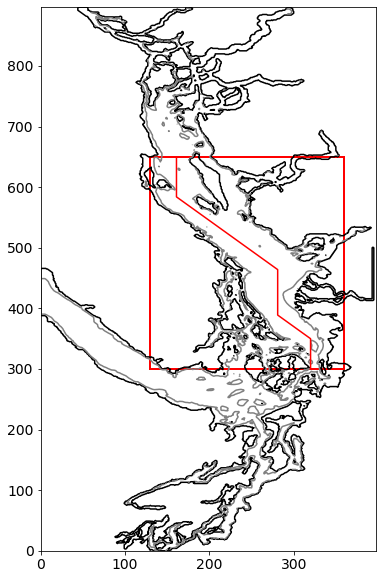

In [3]:
mask = xr.open_dataset('/home/bmoorema/MEOPAR/grid/mesh_mask202108.nc')
bathymetry = xr.open_dataset('/home/bmoorema/MEOPAR/grid/bathymetry_202108.nc')
bathy = bathymetry.Bathymetry.values
tmask = mask.tmask.values[0, 0, ...]
bbox = [130, 360, 300, 650]

fig, ax = plt.subplots(figsize=(6, 10))
ax.contour(tmask, levels=[-0.01, 0.01], colors='k')
ax.contour(bathy, levels=[50], colors='gray')
xy, dx, dy = (bbox[0], bbox[2]), bbox[1]-bbox[0], bbox[3]-bbox[2]
ax.add_patch(patches.Rectangle(xy, dx, dy, fill=False, lw=2, ec='r'))

x0 = np.repeat(320, 50)
y0 = np.arange(300, 350)

x1 = np.arange(320, 280, -1)
y1 = (670 - x1).astype(int)

x2 = np.repeat(281, 75)
y2 = np.arange(390, 465)

x3 = np.arange(280, 160, -1)
y3 = (745 - x3).astype(int)

x4 = np.repeat(161, 65)
y4 = np.arange(585, 650)

xsec = np.hstack([x0, x1, x2, x3, x4])
ysec = np.hstack([y0, y1, y2, y3, y4])

xplan = np.arange(*bbox[:2])
yplan = np.arange(*bbox[2:])
depth = mask.gdept_1d[0, :20].values

ax.plot(xsec, ysec, 'r-')

In [7]:
# Run params
path = '/project/def-allen/bmoorema/results/Currents/'
slice_bbox = {'y': slice(*bbox[2:]), 'x': slice(*bbox[:2])}
runIDs = ['nowaves', 'frachs08', 'base', 'frachs13', 'charnock']
variables = ['vosaline', 'vozocrtx', 'vomecrty']
slices = {
    'plan': (slice(None), 0, slice(None), slice(None)),
    'tsec': (slice(None), slice(None), ysec-bbox[2], xsec-bbox[0]),
}

# Initialize data dict
data = {runID: {var: {slc: [] for slc in slices} for var in variables} for runID in runIDs}

# Convolution window
window = signal.get_window('boxcar', 5)
window = window / sum(window)

for runID in tqdm(runIDs):
    
    for datestr in ['20160401_20160930', '20161001_20170331', '20170401_20170930']:

        folder = f'SalishSeaCast_currenttuning_{runID}_{datestr}/'

        for var, gridtype in zip(variables, ['T', 'U', 'V']):

            fn = f'SalishSea_1d_{datestr}_grid_{gridtype}.nc'
            slc = {f'depth{gridtype.lower()}': slice(0, 20), **slice_bbox} 
            values = xr.open_dataset(path + folder + fn)[var].isel(**slc).values

            for slc in slices:

                data[runID][var][slc].append(ndimage.convolve1d(values[slices[slc]], window, axis=0))

for runID in runIDs:
    for var in variables:
        for slc in slices:
            data[runID][var][slc] = np.concatenate(data[runID][var][slc])

100%|████████████████████████████████████████████████████████████████| 5/5 [44:20<00:00, 532.13s/it]


In [62]:
def next_frame(day):
    """
    """
    
    date = datetime(2016, 4, 1) + timedelta(days=day)
    winddate.set_data([date, date], [-5, 5])
    
    # Loop through runs
    for axs, slc in zip([axs_plan, axs_sec], ['plan', 'tsec']):
        
        if slc == 'plan':
            xplot, yplot = xplan, yplan
        else:
            xplot, yplot = depth, ysec
    
        for col, runID in zip(axs.T, contours[slc]):

            # Loop through plot type
            for ax, field in zip(col, contours[slc][runID]):

                # Clear previous salinity contours
                try:
                    for c in contours[slc][runID][field].collections:
                        c.remove()
                except:
                    pass

                # Define plotting arguments
                if field == 'anomaly':
                    z = data[runID]['vosaline'][slc][day, ...] - data['nowaves']['vosaline'][slc][day, ...]
                    levels, cmap = np.arange(-2, 2.1, 0.1), 'RdBu_r'
                else:
                    z = data[runID]['vosaline'][slc][day, ...]
                    levels, cmap = np.arange(5, 31), 'viridis'

                # Plot panel
                if slc == 'tsec':
                    z = z.T
                
                contours[slc][runID][field] = ax.contourf(xplot, yplot, z, levels=levels, cmap=cmap, extend='both')
                
                # Plot quivers
                if slc == 'plan':
                    u = np.add(data[runID]['vozocrtx']['plan'][day, :, :-1], data[runID]['vozocrtx']['plan'][day, :, 1:]) / 2
                    v = np.add(data[runID]['vomecrty']['plan'][day, :-1, :], data[runID]['vomecrty']['plan'][day, 1:, :]) / 2
                    u, v = u[1:, :][::10, ::10], v[:, 1:][::10, ::10]
                    quivers[runID].set_UVC(u, v)

  0%|                                                                       | 0/548 [00:00<?, ?it/s]

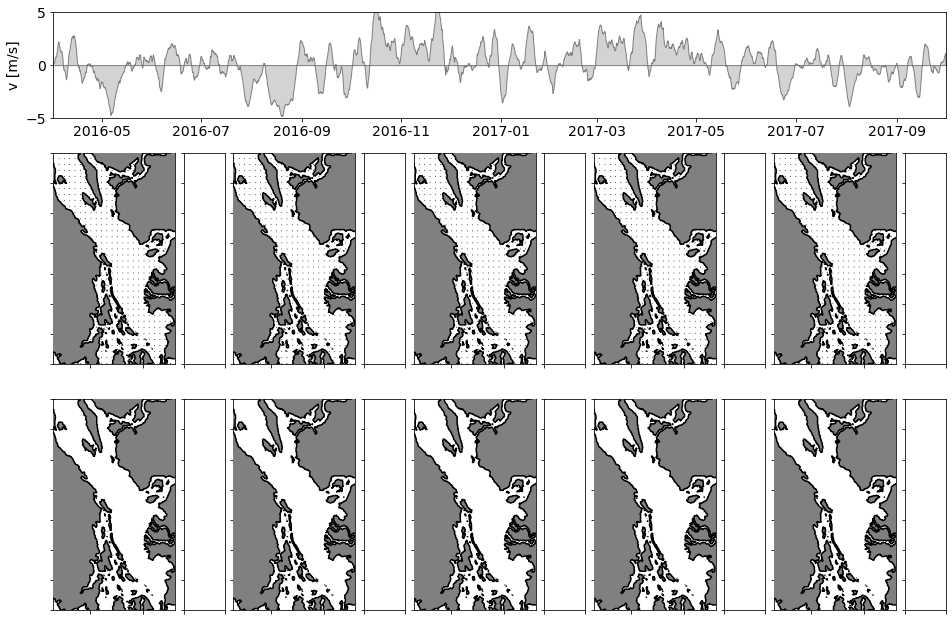

In [72]:
#%%capture
contours = {slc: {runID: {'value': [], 'anomaly': []} for runID in data} for slc in ['plan', 'tsec']}
quivers = {runID: [] for runID in data}

fig = plt.figure(figsize=(16, 11))

gs = plt.GridSpec(3, 10, wspace=0.1, hspace=0.2, width_ratios=[3, 1, 3, 1, 3, 1, 3, 1, 3, 1], height_ratios=[1, 2, 2])

ax_wind = fig.add_subplot(gs[0, :])
ax_wind.fill_between(time_HRDPS, v_smooth, fc='lightgray', ec='gray')
ax_wind.set_xlim([datetime(2016, 4, 1), datetime(2017, 10, 1)])
ax_wind.set_ylim([-5, 5])
ax_wind.set_ylabel('v [m/s]')
winddate, = ax_wind.plot([], [], 'k--')

axs_plan = []
axs_sec = []

for row in range(1, 3):
    
    for col in range(0, 10, 2):
        
        ax = fig.add_subplot(gs[row, col])
        ax.contourf(tmask, levels=[-0.01, 0.01], colors='gray', zorder=10)
        ax.contour(tmask, levels=[-0.01, 0.01], colors='k', zorder=10)
        ax.set_aspect(5/4.4)
        ax.xaxis.set_ticklabels('')
        ax.yaxis.set_ticklabels('')
        ax.set_xlim(bbox[:2])
        ax.set_ylim(bbox[2:])
        axs_plan.append(ax)
    
    for col in range(1, 10, 2):
        ax = fig.add_subplot(gs[row, col])
        ax.xaxis.set_ticklabels('')
        ax.yaxis.set_ticklabels('')
        ax.set_xlim([0, 20])
        ax.set_ylim(bbox[2:])
        axs_sec.append(ax)

axs_plan = np.array(axs_plan).reshape(2, 5)
axs_sec = np.array(axs_sec).reshape(2, 5)

day = 0
for ax, runID in zip(axs_plan[0, :], data):
    dummy = np.zeros((len(yplan[1:][::10]), len(xplan[1:][::10])))
    quivers[runID] = ax.quiver(xplan[1:][::10], yplan[1:][::10], dummy, dummy, scale=4, width=0.008, zorder=9)

anim = animation.FuncAnimation(fig, next_frame, frames=tqdm(range(548)), interval=200)

In [73]:
HTML(anim.to_html5_video())

100%|████████████████████████████████████████████████████████████▉| 547/548 [24:11<00:02,  2.60s/it]

In [17]:
HRDPS_path = '/project/def-allen/SalishSea/forcing/atmospheric/GEM2.5/operational/'

startdate = datetime(2016, 4, 1)
u_wind, v_wind = [], []
for day in tqdm(range(548)):
    date = startdate + timedelta(days=day)
    fn = date.strftime('ops_y%Ym%md%d.nc')
    u, v = [xr.open_dataset(HRDPS_path + fn)[var].isel(y=135, x=151).values for var in ['u_wind', 'v_wind']]
    u_wind.append(u)
    v_wind.append(v)
    
time_HRDPS = np.array([startdate + timedelta(hours=hour) for hour in range(548*24)])
u_wind = np.hstack(u_wind)
v_wind = np.hstack(v_wind)
wspd2 = u_wind**2 + v_wind**2

window = signal.get_window('boxcar', 120)
window = window / sum(window)
wspd2_smooth = np.convolve(wspd2, window, mode='same')
v_smooth = np.convolve(v_wind, window, mode='same')

100%|█████████████████████████████████████████████████████████████| 548/548 [02:56<00:00,  3.10it/s]
